<a href="https://colab.research.google.com/github/niikkkhiil/Credit-Card-Fraud-Detection/blob/main/Credit_Card_Fraud_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
df = pd.read_csv('/content/creditCardFraud_28011964_120214.csv')
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,50000,1,2,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
1,50000,1,1,2,37,0,0,0,0,0,...,19394,19619,20024,2500,1815,657,1000,1000,800,0
2,500000,1,1,2,29,0,0,0,0,0,...,542653,483003,473944,55000,40000,38000,20239,13750,13770,0
3,100000,2,2,2,23,0,-1,-1,0,0,...,221,-159,567,380,601,0,581,1687,1542,0
4,140000,2,3,1,28,0,0,2,0,0,...,12211,11793,3719,3329,0,432,1000,1000,1000,0


In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
LIMIT_BAL,1001.0,167532.467532,130587.921320,10000.0,50000.0,140000.0,240000.0,700000.0
SEX,1001.0,1.589411,0.492187,1.0,1.0,2.0,2.0,2.0
EDUCATION,1001.0,1.776224,0.750916,1.0,1.0,2.0,2.0,6.0
MARRIAGE,1001.0,1.604396,0.532298,0.0,1.0,2.0,2.0,3.0
AGE,1001.0,34.945055,9.219760,21.0,28.0,33.0,41.0,75.0
PAY_0,1001.0,-0.004995,1.173446,-2.0,-1.0,0.0,0.0,8.0
PAY_2,1001.0,-0.161838,1.228732,-2.0,-1.0,0.0,0.0,7.0
PAY_3,1001.0,-0.164835,1.262459,-2.0,-1.0,0.0,0.0,7.0
PAY_4,1001.0,-0.283716,1.184662,-2.0,-1.0,0.0,0.0,7.0
PAY_5,1001.0,-0.283716,1.170224,-2.0,-1.0,0.0,0.0,7.0


In [ ]:
!pip install pydantic-settings

In [ ]:
!pip install pandas_profiling

In [ ]:
!pip install ydata-profiling

In [ ]:
from ydata_profiling import ProfileReport

In [ ]:
profile = ProfileReport(df, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df.isnull().sum()

,0
LIMIT_BAL,0
SEX,0
EDUCATION,0
MARRIAGE,0
AGE,0
PAY_0,0
PAY_2,0
PAY_3,0
PAY_4,0
PAY_5,0


In [ ]:
df.duplicated().sum()

0

In [ ]:
df.skew()

,0
LIMIT_BAL,1.011019
SEX,-0.364047
EDUCATION,0.875019
MARRIAGE,-0.104653
AGE,0.817570
PAY_0,1.509158
PAY_2,1.208410
PAY_3,1.226851
PAY_4,1.217037
PAY_5,1.053218


In [ ]:
x = df.drop('default payment next month', axis = 1)
y = df['default payment next month']

In [ ]:
x.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
0,50000,1,2,1,57,-1,0,-1,0,0,...,35835,20940,19146,19131,2000,36681,10000,9000,689,679
1,50000,1,1,2,37,0,0,0,0,0,...,57608,19394,19619,20024,2500,1815,657,1000,1000,800
2,500000,1,1,2,29,0,0,0,0,0,...,445007,542653,483003,473944,55000,40000,38000,20239,13750,13770
3,100000,2,2,2,23,0,-1,-1,0,0,...,601,221,-159,567,380,601,0,581,1687,1542
4,140000,2,3,1,28,0,0,2,0,0,...,12108,12211,11793,3719,3329,0,432,1000,1000,1000


In [ ]:
y.head()

,default payment next month
0,0
1,0
2,0
3,0
4,0


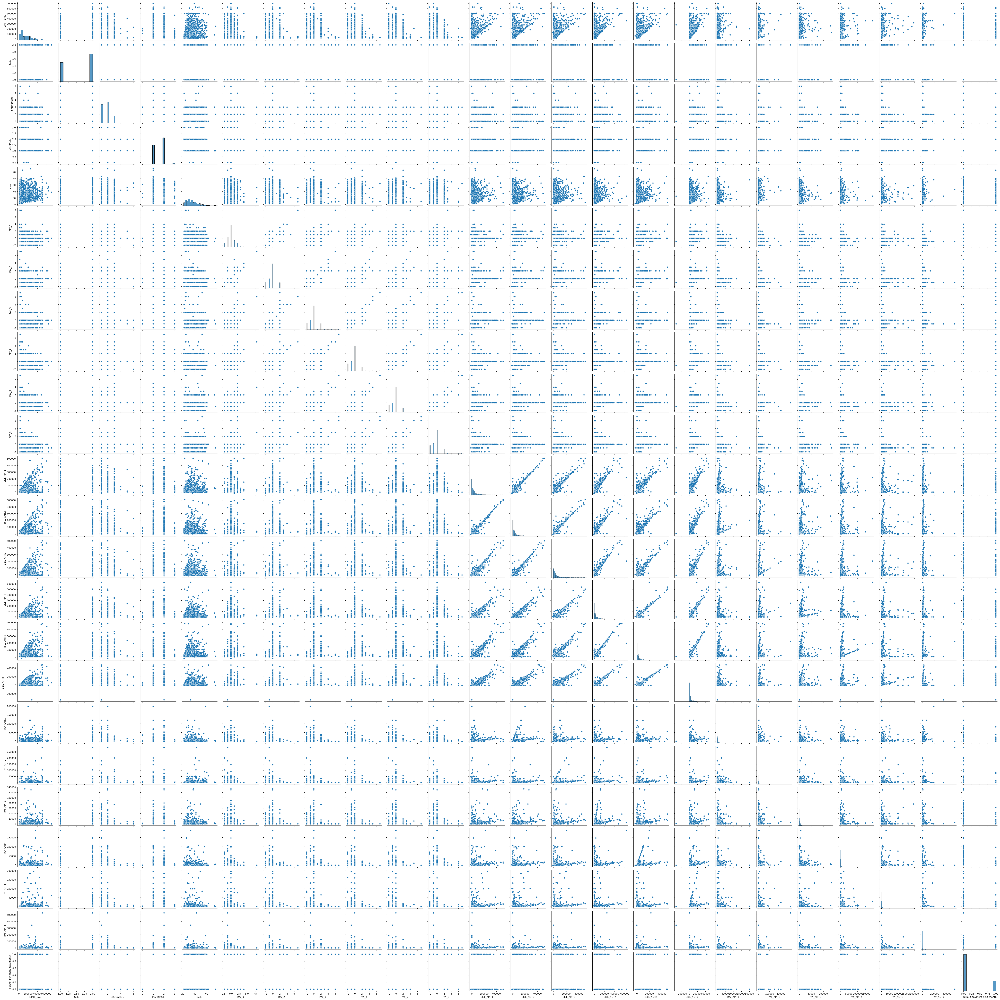

In [ ]:
 import matplotlib.pyplot as plt
 import seaborn as sns

 sns.pairplot(df)
 plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

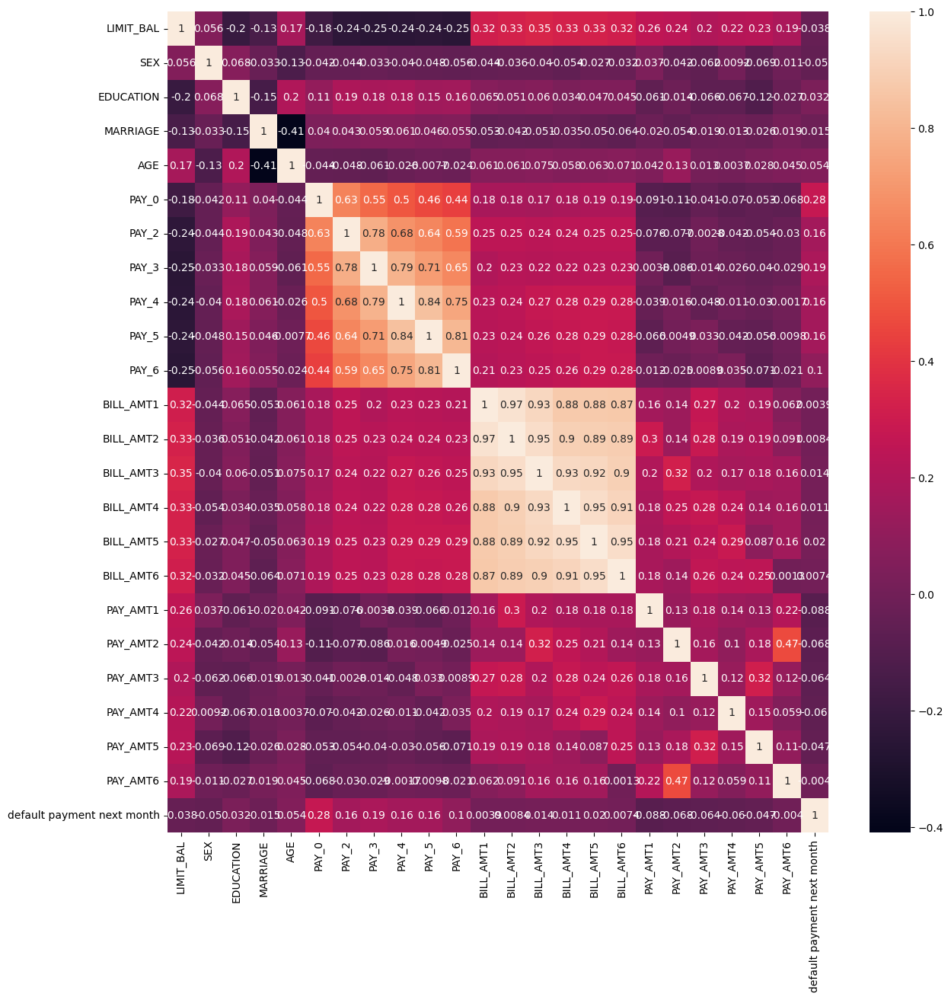

In [ ]:
plt.figure(figsize = (14, 14))
sns.heatmap(df.corr(), annot = True)
plt.show

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size= 0.30, random_state=42)
x_train

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
440,240000,1,1,2,44,0,0,0,0,0,...,234557,200643,194410,198857,12026,9010,7400,8000,8000,7000
482,230000,2,1,1,42,-1,-1,-1,-1,-1,...,13165,0,10500,6992,15111,13165,0,10500,6992,0
422,20000,2,3,2,49,2,2,2,2,0,...,13087,12583,15327,16414,3000,1500,0,3123,1500,1000
852,40000,2,1,2,29,0,0,2,2,2,...,30145,29361,33893,34487,3400,1500,0,5000,1300,0
950,110000,2,2,1,46,-1,-1,-1,-1,-1,...,2161,1719,107591,107940,2151,2161,1719,107591,5000,3500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106,330000,2,1,1,31,0,0,2,0,0,...,105594,105896,106491,107289,9260,0,3593,4100,15794,0
270,360000,2,2,2,28,-2,-2,-2,-2,-2,...,0,0,0,0,0,0,0,0,0,0
860,200000,1,1,2,32,0,0,0,0,0,...,45574,49022,47459,49666,1739,1756,2662,1726,3000,2500
435,80000,2,1,2,23,0,0,0,0,0,...,57806,37642,46235,47110,3212,1600,956,40000,1800,1700


In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
xtrain = sc.fit_transform(x_train)
xtest = sc.fit_transform(x_test)

In [ ]:
x_train

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
440,240000,1,1,2,44,0,0,0,0,0,...,234557,200643,194410,198857,12026,9010,7400,8000,8000,7000
482,230000,2,1,1,42,-1,-1,-1,-1,-1,...,13165,0,10500,6992,15111,13165,0,10500,6992,0
422,20000,2,3,2,49,2,2,2,2,0,...,13087,12583,15327,16414,3000,1500,0,3123,1500,1000
852,40000,2,1,2,29,0,0,2,2,2,...,30145,29361,33893,34487,3400,1500,0,5000,1300,0
950,110000,2,2,1,46,-1,-1,-1,-1,-1,...,2161,1719,107591,107940,2151,2161,1719,107591,5000,3500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106,330000,2,1,1,31,0,0,2,0,0,...,105594,105896,106491,107289,9260,0,3593,4100,15794,0
270,360000,2,2,2,28,-2,-2,-2,-2,-2,...,0,0,0,0,0,0,0,0,0,0
860,200000,1,1,2,32,0,0,0,0,0,...,45574,49022,47459,49666,1739,1756,2662,1726,3000,2500
435,80000,2,1,2,23,0,0,0,0,0,...,57806,37642,46235,47110,3212,1600,956,40000,1800,1700


In [ ]:
scale_train_df = pd.DataFrame(xtrain, columns = x_train.columns, index = x_train.index)
scale_test_df = pd.DataFrame(xtest, columns = x_test.columns, index = x_test.index)


In [ ]:
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier # ensemble means combination of multiple models and here is a decision tree

model_nb = GaussianNB()
model_rf = RandomForestClassifier(n_estimators=100)

model_nb.fit(scale_train_df, y_train)
model_rf.fit(scale_train_df, y_train)


RandomForestClassifier()

In [ ]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

y_pred_nb = model_nb.predict(scale_test_df)
print(f'Accuracy Score: {accuracy_score(y_test, y_pred_nb)}')

y_pred_rf = model_rf.predict(scale_test_df)
print(f'Accuracy Score: {accuracy_score(y_test, y_pred_rf)}')


Accuracy Score: 0.6710963455149501
Accuracy Score: 0.8172757475083057


In [ ]:
print (confusion_matrix(y_test, y_pred_nb))
print (classification_report(y_test, y_pred_nb))

[[171  80]
 [ 19  31]]
              precision    recall  f1-score   support

           0       0.90      0.68      0.78       251
           1       0.28      0.62      0.39        50

    accuracy                           0.67       301
   macro avg       0.59      0.65      0.58       301
weighted avg       0.80      0.67      0.71       301



In [ ]:
print (confusion_matrix(y_test, y_pred_rf))
print (classification_report(y_test, y_pred_rf))

[[236  15]
 [ 40  10]]
              precision    recall  f1-score   support

           0       0.86      0.94      0.90       251
           1       0.40      0.20      0.27        50

    accuracy                           0.82       301
   macro avg       0.63      0.57      0.58       301
weighted avg       0.78      0.82      0.79       301



In [ ]:
from sklearn.model_selection import GridSearchCV
param_grid = {
    'var_smoothing': [0.1, 0.01, 0.5, 0.005, 0.0001, 1e-6, 1e-7, 1e-8, 1e-10, 1e-11]}


In [ ]:
grid = GridSearchCV(estimator=model_nb, param_grid=param_grid, cv=5, verbose = 3)
grid.fit(scale_train_df, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END .................var_smoothing=0.1;, score=0.364 total time=   0.0s
[CV 2/5] END .................var_smoothing=0.1;, score=0.764 total time=   0.0s
[CV 3/5] END .................var_smoothing=0.1;, score=0.721 total time=   0.0s
[CV 4/5] END .................var_smoothing=0.1;, score=0.679 total time=   0.0s
[CV 5/5] END .................var_smoothing=0.1;, score=0.714 total time=   0.0s
[CV 1/5] END ................var_smoothing=0.01;, score=0.336 total time=   0.0s
[CV 2/5] END ................var_smoothing=0.01;, score=0.743 total time=   0.0s
[CV 3/5] END ................var_smoothing=0.01;, score=0.693 total time=   0.0s
[CV 4/5] END ................var_smoothing=0.01;, score=0.679 total time=   0.0s
[CV 5/5] END ................var_smoothing=0.01;, score=0.693 total time=   0.0s
[CV 1/5] END .................var_smoothing=0.5;, score=0.714 total time=   0.0s
[CV 2/5] END .................var_smoothing=0.5;

GridSearchCV(cv=5, estimator=GaussianNB(),
             param_grid={'var_smoothing': [0.1, 0.01, 0.5, 0.005, 0.0001, 1e-06,
                                           1e-07, 1e-08, 1e-10, 1e-11]},
             verbose=3)

In [ ]:
grid.best_params_

{'var_smoothing': 0.5}

In [ ]:
model_nb_tuned = GaussianNB(var_smoothing=0.5)
model_nb_tuned.fit(scale_train_df, y_train)
y_pred_nb_tuned = model_nb_tuned.predict(scale_test_df)

print(f'Accuracy Score: {accuracy_score(y_test, y_pred_nb_tuned)}')
print(f'Confusion Matrix: {confusion_matrix(y_test, y_pred_nb_tuned)}')
print(classification_report(y_test, y_pred_nb_tuned))

Accuracy Score: 0.7807308970099668
Confusion Matrix: [[216  35]
 [ 31  19]]
              precision    recall  f1-score   support

           0       0.87      0.86      0.87       251
           1       0.35      0.38      0.37        50

    accuracy                           0.78       301
   macro avg       0.61      0.62      0.62       301
weighted avg       0.79      0.78      0.78       301



In [ ]:
param_grid = {
    'n_estimators': [50, 100, 150, 200],
    'max_depth': range(3, 11, 1),
    'random_state': [0,50,100,42],
    'criterion': ['gini', 'entropy']
}

grid2 = GridSearchCV(estimator=model_rf, param_grid=param_grid, cv=5, verbose = 3)
grid2.fit(scale_train_df, y_train)
print(grid2.best_estimator_)

Fitting 5 folds for each of 256 candidates, totalling 1280 fits
[CV 1/5] END criterion=gini, max_depth=3, n_estimators=50, random_state=0;, score=0.764 total time=   0.2s
[CV 2/5] END criterion=gini, max_depth=3, n_estimators=50, random_state=0;, score=0.764 total time=   0.2s
[CV 3/5] END criterion=gini, max_depth=3, n_estimators=50, random_state=0;, score=0.779 total time=   0.1s
[CV 4/5] END criterion=gini, max_depth=3, n_estimators=50, random_state=0;, score=0.793 total time=   0.1s
[CV 5/5] END criterion=gini, max_depth=3, n_estimators=50, random_state=0;, score=0.757 total time=   0.1s
[CV 1/5] END criterion=gini, max_depth=3, n_estimators=50, random_state=50;, score=0.779 total time=   0.1s
[CV 2/5] END criterion=gini, max_depth=3, n_estimators=50, random_state=50;, score=0.743 total time=   0.2s
[CV 3/5] END criterion=gini, max_depth=3, n_estimators=50, random_state=50;, score=0.779 total time=   0.2s
[CV 4/5] END criterion=gini, max_depth=3, n_estimators=50, random_state=50;, 

In [ ]:
best_params = grid2.best_params_

In [ ]:
model_rf_tuned = RandomForestClassifier(**best_params)
model_rf_tuned.fit(scale_train_df, y_train)
y_pred_rf_tuned = model_rf_tuned.predict(scale_test_df)

print(f'Accuracy Score: {accuracy_score(y_test, y_pred_rf_tuned)}')
print(confusion_matrix(y_test, y_pred_rf_tuned))
print(classification_report(y_test, y_pred_rf_tuned))

Accuracy Score: 0.8338870431893688
[[243   8]
 [ 42   8]]
              precision    recall  f1-score   support

           0       0.85      0.97      0.91       251
           1       0.50      0.16      0.24        50

    accuracy                           0.83       301
   macro avg       0.68      0.56      0.57       301
weighted avg       0.79      0.83      0.80       301

